### Initial DCGAN Testing
This notebook is based on the tutorial for a DCGAN from PyTorch, modified to take in my pokemon data. I've included markdown notes for myself which come from the tutorial website.

### What is a GAN!?!
- Generative Adverserial Networks were introduced in [Goodfellow et al.](https://proceedings.neurips.cc/paper/2014/file/5ca3e9b122f61f8f06494c97b1afccf3-Paper.pdf)
- Use two models: a generator and a discriminator
- The generator creates 'fake' images which are meant to look like the training data
- The discriminator looks at an image and determines whether it was a real training image or a fake one
- During training, the generator tries to get better at making fake images while the discriminator tries to become a better detective to suss out the fakes
- Ideally, the equilibrium of this game occurs when the generator creates perfect fakes where the discriminator can do no better than chance (50% confidence)
- D(x) is the notation for the scalar probability value that an image is real or fake (1 == real, 0 == fake)
- G(z) is an image generated from a latent vector z
- Thus D(G(z)) is a probability (scalar) that the output image from G is a real image
- The two play a minimax game: min_G max_D (D, G) = E_x~p_data(x)[log(D(x))] + E_z~p_z(z) [log(1-D(G(z)))]
- solution is where p_g = p_data = 50%
- The convergence theory of these models is still being actively researched and models do not always train to this point

### What is a DCGAN?!?
- Introduced in [Radford et al.](https://arxiv.org/pdf/1511.06434.pdf)
- Uses a series of convolutional transpose layers, batch norms and relu functions in the generator
- Uses a series of convolutional, batch norm, and leaky relu functions in the discriminator
- D E E P
- The above paper also provides instructions on how to initialize the weights, setup the optimizers, calculate the loss functions, etc.  

In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

C:\Users\canof\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Random Seed:  999


In [2]:
# Root directory for dataset
dataroot = "../sprites"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128 # originally 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
# NOTE: Changed this to 96 for my pokemon sprite dataset
image_size = 96 

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 16 # originally 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 1000

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

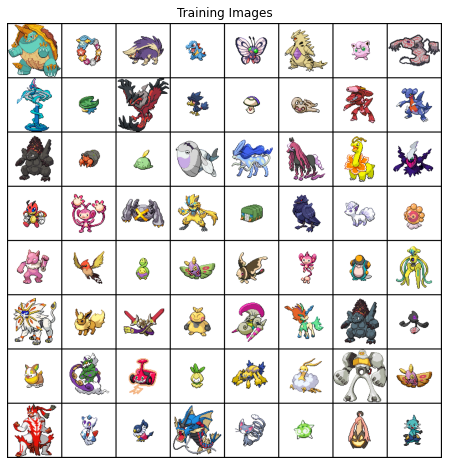

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
print(len(dataloader.dataset))

2479


### Initialize Weights
The GAN paper prescribes initializing convolutional layers with values in N(0, 0.02), batch layers are initialized with values in N(1, 0.02) 

In [5]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### Generator

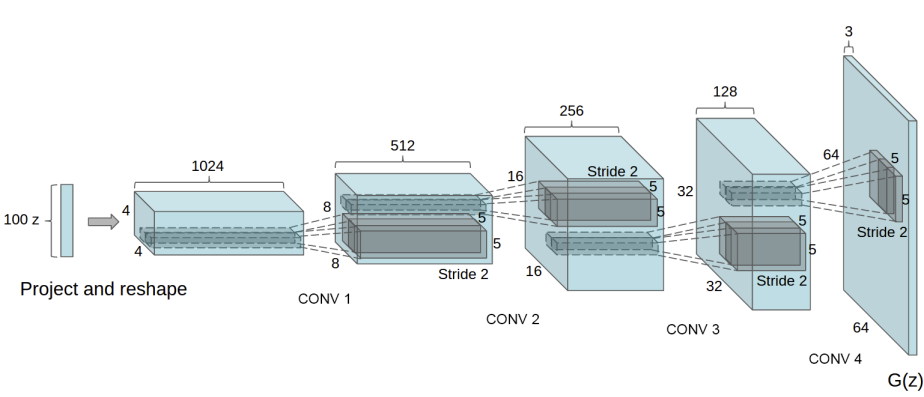

- The generator turns a latent vector _z_ into an image of dimension (3x96x96) in our case. 
- This is accomplished by a series of 2-dimensional convolutional layers paired with a 2-d batch normalization layer and a relu activation function.
- The output is fed through tanh to get values in [-1, 1]
- The batch norm layers are a significant contribution of the GAN paper, they help the flow of gradients during training




In [6]:
# Code for 3 x 96 x 96 generator

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            # Major change between tutorial happens here as I need to end up with a 3x96x96 image
            nn.ConvTranspose2d( nz, ngf * 8, 6, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            # Original model used an inplace ReLU, ganhacks suggests using leakyReLU in both G and D
            nn.LeakyReLU(0.2, inplace=True), 
            # state size: (ngf*8) x 6 x 6
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ngf*4) x 12 x 12
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ngf*2) x 24 x 24
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ngf) x 48 x 48
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size: (nc) x 96 x 96
        )
    
    def forward(self, input):
        return self.main(input)

In [7]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(16, 512, kernel_size=(6, 6), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): ConvTransp

In [8]:
# # test generator output size
# test_input = torch.rand((1, 100, 1, 1)).to(device)
# out = netG(test_input)

# out.size()

### Discriminator
- It's goal is to classify an image as either real or fake through a series of convolutional layers, batch norms and leaky relu non-linearities
- This process can be extended with more convolutional layers if needed
- The sigmoid function at the end spits out a probability that the image is fake or not
- NOTE: The DCGAN paper points out the preference for using a combo of stride and padding for downsampling instead of max pooling as it allows the network to learn it's own pooling function
- Batch Norm and Leaky ReLU are there to promote healthy gradient flow, which is critical for training both G and D

In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input: (nc) x 96 x 96
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf) x 48 x 48
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf * 2) x 24 x 24
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf * 4) x 12 x 12
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf * 8) x 6 x 6
            nn.Conv2d(ndf * 8, 1, 6, 1, 0, bias=False),
            nn.Sigmoid()
        )
    
    def forward(self, input):
        return self.main(input)

In [10]:
# create the discriminator

netD = Discriminator(ngpu).to(device)

# Parallelization
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(6, 6), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [11]:
# # test discriminator output size
# test_input = torch.rand((1, 3, 96, 96)).to(device)
# out = netD(test_input)

# out.size()

### Loss Function
- The DCGAN paper outlines using Binary Cross Entropy loss
- l(x, y) = L = {l_1, ..., l_N}^T where l_i = -[y_i * log(x_i) + (1 - y_i) * log(1 - x_i)] for i in [1, N]

In [12]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

### Training
- Training a GAN is less of a science and more of an art
- We will follow Algorithm 1 from Goodfellow et al. (DCGAN paper) w/ some tricks
- Will use separate mini batches for real and fake images as well as adjusting G's object to maximize log(D(G(z)))
- Tricks can be found here: [ganhacks](https://github.com/soumith/ganhacks)
- Training is split into two parts: training the Discriminator and training the Generator

##### Part 1: Train the Discriminator
- Want to maximize log(D(x)) + log(1 - D(G(z)))
- Due to separate mini-batching for real and fake images, we calculate this in two steps
- First, construct a batch with real samples, forward pass, calculate the loss log(D(x)), and calculate the gradients in a backwards pass
- Second, construct a batch with fake samples with the current generator, forward pass this through D, calculate the loss log(1 - D(G(z))) and _accumulate_ the gradients with a backward pass
- With gradients accumulated from both batches, we call a step of D's optimizer

##### Part 2: Train the generator
- As stated, the goal of the generator is to minimize log(1 - D(G(z))), though in practice this does not provide sufficient gradients (especially early in the training process)
- As a fix, we will max log(D(G(z)))
- This is accomplished by: classifying the G's output in Part 1 with D
- calculate G's loss using _real labels as GT_
- Computing G's gradients in a backward pass and updating G's parameters with an optimizer step
- Using real labels seems strange, but it allows us to use the log(x) part of BCELoss instead of the log(1-x)

##### Reporting
- **Loss_D**: discriminator loss as the sum of losses for all the real and fake batches aka log(D(x)) + log(1 - D(G(z)) 
- **Loss_G**: log(D(G(z)))
- **D(x)**: the average output (across the batch) of the discriminator for the all real batch. Should start at 1 and converge to 0.5 as G improves
- **D(G(z))**: average discriminator outputs for all the fake batch, should start near 0 and converge to 0.5

In [13]:
# Training loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 10 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/1000][0/20]	Loss_D: 1.9294	Loss_G: 5.6833	D(x): 0.5519	D(G(z)): 0.5461 / 0.0081
[0/1000][10/20]	Loss_D: 0.3831	Loss_G: 8.2986	D(x): 0.9212	D(G(z)): 0.1477 / 0.0005
[1/1000][0/20]	Loss_D: 1.9622	Loss_G: 20.4363	D(x): 0.9425	D(G(z)): 0.6289 / 0.0000
[1/1000][10/20]	Loss_D: 2.5335	Loss_G: 18.5455	D(x): 0.3979	D(G(z)): 0.0000 / 0.0000
[2/1000][0/20]	Loss_D: 16.1868	Loss_G: 17.2169	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
[2/1000][10/20]	Loss_D: 6.8363	Loss_G: 5.7023	D(x): 0.0224	D(G(z)): 0.0000 / 0.0415
[3/1000][0/20]	Loss_D: 0.5857	Loss_G: 9.4340	D(x): 0.9168	D(G(z)): 0.2000 / 0.0002
[3/1000][10/20]	Loss_D: 0.4303	Loss_G: 4.1709	D(x): 0.9260	D(G(z)): 0.1122 / 0.0426
[4/1000][0/20]	Loss_D: 5.7810	Loss_G: 0.6550	D(x): 0.0290	D(G(z)): 0.0000 / 0.6101
[4/1000][10/20]	Loss_D: 1.7199	Loss_G: 1.5437	D(x): 0.2926	D(G(z)): 0.0004 / 0.2782
[5/1000][0/20]	Loss_D: 0.3892	Loss_G: 4.2611	D(x): 0.7901	D(G(z)): 0.0220 / 0.0226
[5/1000][10/20]	Loss_D: 0.2689	Loss_G: 5.4402	D(x): 

KeyboardInterrupt: 

### Results

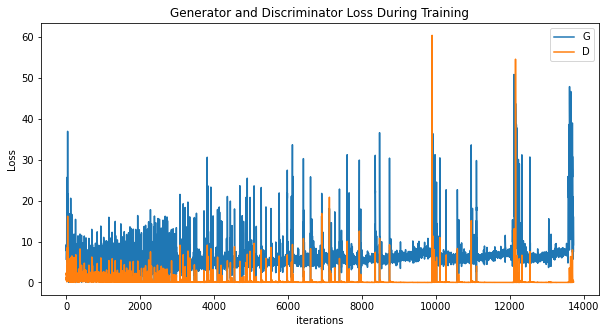

In [14]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

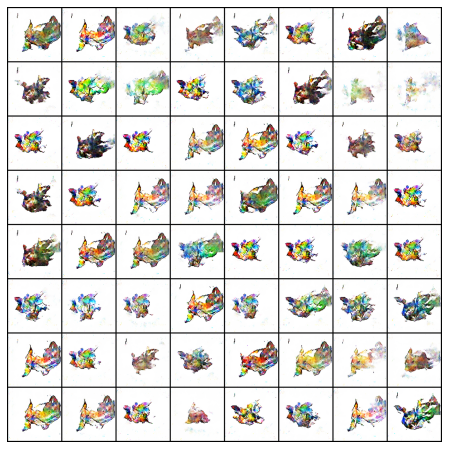

In [17]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [19]:
# Save animation

HTML(ani.to_jshtml()).data


<link rel="stylesheet"
href="https://maxcdn.bootstrapcdn.com/font-awesome/4.4.0/css/font-awesome.min.css">
<script language="javascript">
  function isInternetExplorer() {
    ua = navigator.userAgent;
    /* MSIE used to detect old browsers and Trident used to newer ones*/
    return ua.indexOf("MSIE ") > -1 || ua.indexOf("Trident/") > -1;
  }

  /* Define the Animation class */
  function Animation(frames, img_id, slider_id, interval, loop_select_id){
    this.img_id = img_id;
    this.slider_id = slider_id;
    this.loop_select_id = loop_select_id;
    this.interval = interval;
    this.current_frame = 0;
    this.direction = 0;
    this.timer = null;
    this.frames = new Array(frames.length);

    for (var i=0; i<frames.length; i++)
    {
     this.frames[i] = new Image();
     this.frames[i].src = frames[i];
    }
    var slider = document.getElementById(this.slider_id);
    slider.max = this.frames.length - 1;
    if (isInternetExplorer()) {
        // switch from oninput to on

##### Ideas to try
1. Soft + Noisy labels - replace real labels w/ [0.7, 1.2] and fake labels with [0, 0.3], occasionally flip labels when training the discriminator
2. Auxiliary GANs - train discriminator to also classify samples (I have a plethora of labels available, will try with types probably)
3. Try using SGD for discrim and ADAM for gen
4. [Article about a PokeGAN](https://towardsdatascience.com/autoencoding-generative-adversarial-networks-16082512b583) and [AEGAN architecture](https://towardsdatascience.com/autoencoding-generative-adversarial-networks-16082512b583)
